# Mask R-CNN with ResNet-50-FPN

In [1]:
# Check Pytorch installation
import torch, torchvision
print(f"PyTorch version={torch.__version__}, {torch.cuda.is_available()=}")

# Check MMDetection installation
import mmdet
print(f"MMDetection version={mmdet.__version__}")

# Check mmcv installation
from mmcv.ops import get_compiling_cuda_version, get_compiler_version
print(f"cuda version={get_compiling_cuda_version()}")
print(f"GCC version={get_compiler_version()}")

PyTorch version=1.10.0, torch.cuda.is_available()=False
MMDetection version=2.22.0
cuda version=not available
GCC version=clang 12.0.5


In [30]:
from pathlib import Path
CUR_DIR = Path().resolve()
ROOT_DIR = CUR_DIR.parent
MMDET_DIR = ROOT_DIR / "mmdetection"
DATA_DIR = ROOT_DIR / "input"

print(f"{CUR_DIR=}")
print(f"{ROOT_DIR=}")
print(f"{MMDET_DIR=}")
print(f"{DATA_DIR=}")

CUR_DIR=PosixPath('/Users/takumiwatanabe/github/takumiw/Instance-Segmentation-PyTorch-Samples/notebook')
ROOT_DIR=PosixPath('/Users/takumiwatanabe/github/takumiw/Instance-Segmentation-PyTorch-Samples')
MMDET_DIR=PosixPath('/Users/takumiwatanabe/github/takumiw/Instance-Segmentation-PyTorch-Samples/mmdetection')
DATA_DIR=PosixPath('/Users/takumiwatanabe/github/takumiw/Instance-Segmentation-PyTorch-Samples/input')


In [6]:
import mmcv
from mmcv.runner import load_checkpoint

from mmdet.apis import inference_detector, show_result_pyplot
from mmdet.models import build_detector

In [7]:
!wget -c https://download.openmmlab.com/mmdetection/v2.0/mask_rcnn/mask_rcnn_r50_fpn_mstrain-poly_3x_coco/mask_rcnn_r50_fpn_mstrain-poly_3x_coco_20210524_201154-21b550bb.pth \
      -O ../mmdetection/checkpoints/mask_rcnn_r50_fpn_mstrain-poly_3x_coco_20210524_201154-21b550bb.pth

--2022-03-20 17:53:33--  https://download.openmmlab.com/mmdetection/v2.0/mask_rcnn/mask_rcnn_r50_fpn_mstrain-poly_3x_coco/mask_rcnn_r50_fpn_mstrain-poly_3x_coco_20210524_201154-21b550bb.pth
Resolving download.openmmlab.com (download.openmmlab.com)... 47.245.16.66
Connecting to download.openmmlab.com (download.openmmlab.com)|47.245.16.66|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 177868694 (170M) [application/octet-stream]
Saving to: ‘../mmdetection/checkpoints/mask_rcnn_r50_fpn_mstrain-poly_3x_coco_20210524_201154-21b550bb.pth’

../mmdetection/chec 100%[===================>] 169.63M  3.75MB/s    in 46s     

2022-03-20 17:54:19 (3.71 MB/s) - ‘../mmdetection/checkpoints/mask_rcnn_r50_fpn_mstrain-poly_3x_coco_20210524_201154-21b550bb.pth’ saved [177868694/177868694]



In [17]:
# Choose to use a config and initialize the detector
config = MMDET_DIR / 'configs/mask_rcnn/mask_rcnn_r50_fpn_mstrain-poly_3x_coco.py'

# Setup a checkpoint file to load
checkpoint = MMDET_DIR / 'checkpoints/mask_rcnn_r50_fpn_mstrain-poly_3x_coco_20210524_201154-21b550bb.pth'

# Set the device to be used for evaluation
device='cpu'

In [18]:
# Load the config
config = mmcv.Config.fromfile(config)

# Set pretrained to be None since we do not need pretrained model here
#config.model.pretrained = None

In [29]:
# Initialize the detector
model = build_detector(config.model)

# Load checkpoint
checkpoint = load_checkpoint(model, str(checkpoint), map_location=device)

# Set the classes of models for inference
model.CLASSES = checkpoint['meta']['CLASSES']

# We need to set the model's cfg for inference
model.cfg = config

# Convert the model to GPU
model.to(device)
# Convert the model into evaluation mode
model.eval()

load checkpoint from local path: /Users/takumiwatanabe/github/takumiw/Instance-Segmentation-PyTorch-Samples/mmdetection/checkpoints/mask_rcnn_r50_fpn_mstrain-poly_3x_coco_20210524_201154-21b550bb.pth


MaskRCNN(
  (backbone): ResNet(
    (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU(inplace=True)
    (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (layer1): ResLayer(
      (0): Bottleneck(
        (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
        (downsample): Sequential(
          

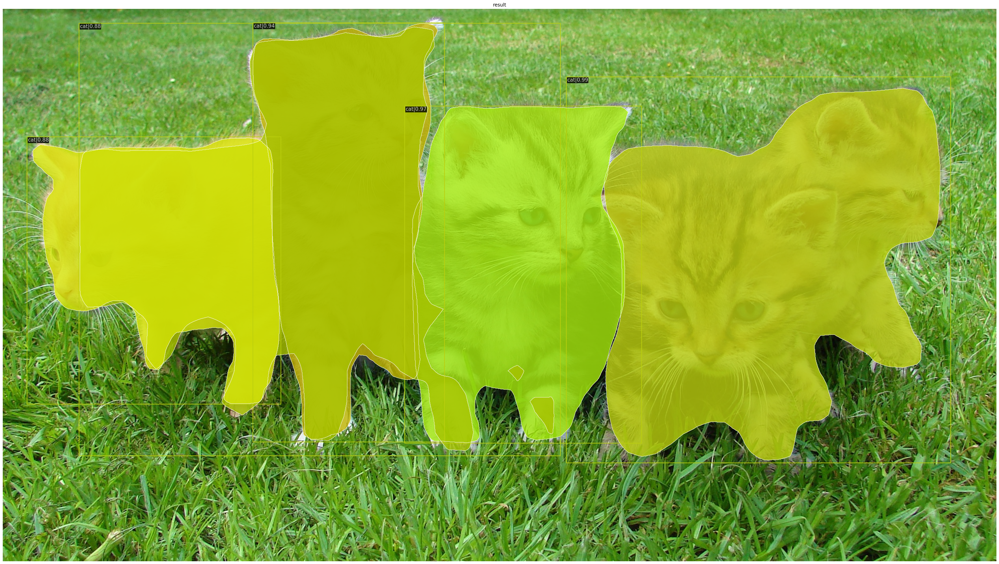

In [38]:
# Use the detector to do inference
img = DATA_DIR / "sample" / "kittens-cat-cat-puppy-rush-45170.jpg"
result = inference_detector(model, img)

# Let's plot the result
show_result_pyplot(model, img, result, score_thr=0.5)

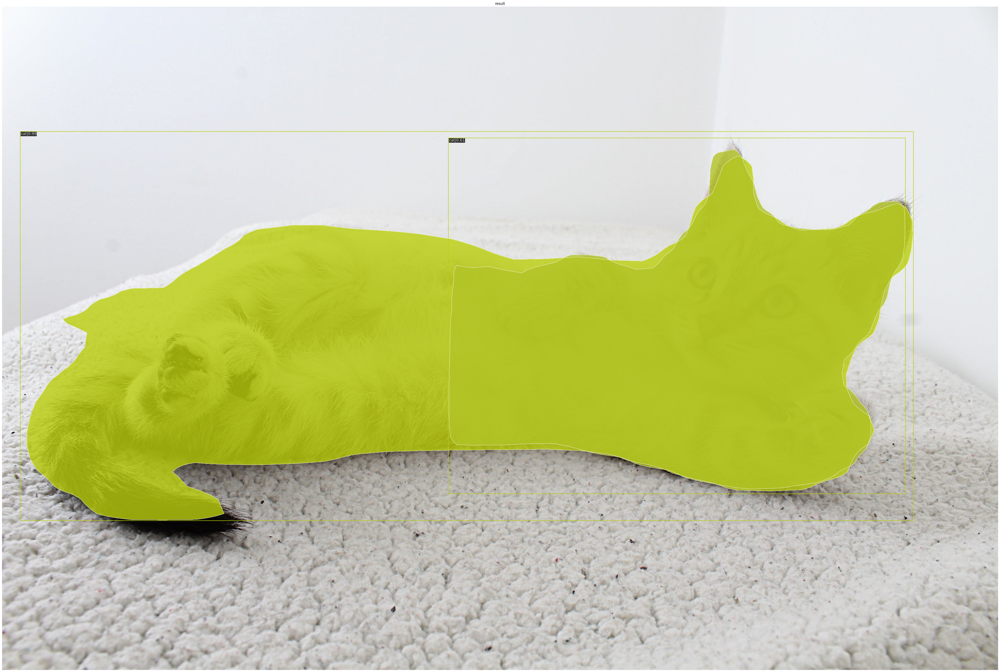

In [39]:
# Use the detector to do inference
img = DATA_DIR / "sample" / "pexels-photo-2558605.jpg"
result = inference_detector(model, img)

# Let's plot the result
show_result_pyplot(model, img, result, score_thr=0.5)